<a href="https://colab.research.google.com/github/akshay-mali/Food-Recipe/blob/food/Food_Custom_Detectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# How to Train Detectron2 on Custom Objects

This tutorial implements the new [Detectron2 Library](https://ai.facebook.com/blog/-detectron2-a-pytorch-based-modular-object-detection-library-/) by facebook. This notebook shows training on **your own custom objects** for object detection.

It is worth noting that the Detectron2 library goes far beyond object detection, supporting semantic segmentation, keypoint detection, mask, and densepose.


### Accompanying Blog Post

We recommend that you follow along in this notebook while reading the blog post on [how to train Detectron2](https://blog.roboflow.ai/how-to-train-detectron2/), concurrently.

### Steps Covered in this Tutorial

In this tutorial, we will walk through the steps required to train Detectron2 on your custom objects. We use a [public blood cell detection dataset](https://public.roboflow.ai/object-detection/bccd), which is open source and free to use. You can also use this notebook on your own data.

To train our detector we take the following steps:

* Install Detectron2 dependencies
* Download custom Detectron2 object detection data
* Visualize Detectron2 training data
* Write our Detectron2 Training configuration
* Run Detectron2 training
* Evaluate Detectron2 performance
* Run Detectron2 inference on test images



### **About**

[Roboflow](https://roboflow.ai) enables teams to deploy custom computer vision models quickly and accurately. Convert data from to annotation format, assess dataset health, preprocess, augment, and more. It's free for your first 1000 source images.

#### ![Roboflow Workmark](https://i.imgur.com/WHFqYSJ.png)

# Install Detectron2 Dependencies

In [1]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
     |████████████████████████████████| 703.8 MB 24 kB/s 
     |████████████████████████████████| 6.6 MB 37.2 MB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.9.0+cu102
    Uninstalling torch-1.9.0+cu102:
      Successfully uninstalled torch-1.9.0+cu102
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.10.0+cu102
    Uninstalling torchvision-0.10.0+cu102:
      Successfully uninstalled torchvision-0.10.0+cu102
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.10.0 requires torch==1.9.0, but you have torch 1.5.0+cu101 which is incompatible.
     |████████████████████████████████| 274 kB 12.0 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=42502d6dce7ff071ad4cb5b4fa19e

In [2]:
# install detectron2:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
     |████████████████████████████████| 6.2 MB 958 kB/s 
     |████████████████████████████████| 49 kB 4.1 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20210825-py3-none-any.whl size=60661 sha256=9a362fe1e7219f77cbed97e47a69d367026b98340afa067b32047df99c77fc8c
  Stored in directory: /root/.cache/pip/wheels/53/c4/f8/c4cb07f135845218b019b4a55d8a0470a0f21ee13f8dcd16be
Successfully built fvcore


In [3]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

# Import and Register Custom Detectron2 Data

In [4]:
!unzip ./foodd.zip;

Archive:  ./foodd.zip
   creating: new/
   creating: new/test/
  inflating: new/test/1000661287.jpg  
  inflating: new/test/1000661287.json  
  inflating: new/test/1000662217.jpg  
  inflating: new/test/1000662217.json  
  inflating: new/test/1000665923.jpg  
  inflating: new/test/1000665923.json  
  inflating: new/test/1000669677.jpg  
  inflating: new/test/1000669677.json  
  inflating: new/test/1000669934.jpg  
  inflating: new/test/1000669934.json  
  inflating: new/test/1000670788.jpg  
  inflating: new/test/1000670788.json  
  inflating: new/test/1000678912.jpg  
  inflating: new/test/1000678912.json  
  inflating: new/test/1000679206.jpg  
  inflating: new/test/1000679206.json  
  inflating: new/test/1000680572.jpg  
  inflating: new/test/1000680572.json  
  inflating: new/test/1000684667.jpg  
  inflating: new/test/1000684667.json  
  inflating: new/test/1000687393.jpg  
  inflating: new/test/1000687393.json  
  inflating: new/test/1000693398.jpg  
  inflating: new/test/1000693

In [5]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "./Bbox/train/annotations.json", "./Bbox/train")
register_coco_instances("my_dataset_val", {}, "./Bbox/validation/annotations.json", "./Bbox/validation")
register_coco_instances("my_dataset_test", {}, "./Bbox/test/annotations.json", "./Bbox/test")

[09/08 07:56:08 d2.data.datasets.coco]: Loaded 1340 images in COCO format from ./Bbox/train/annotations.json


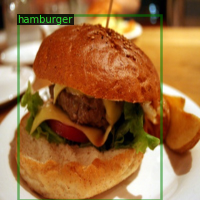

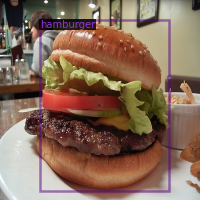

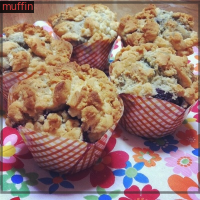

In [7]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Train Custom Detectron2 Detector

In [8]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [10]:
#from .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer
# select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines

from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 1600
cfg.SOLVER.MAX_ITER = 2000 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (1600, 2000)
cfg.SOLVER.GAMMA = 0.05




cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 10 #your number of classes + 1

cfg.TEST.EVAL_PERIOD = 400


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[09/08 07:57:23 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_68b088.pkl: 421MB [00:34, 12.1MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (11, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (11,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (40, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (40,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box

[09/08 07:58:00 d2.engine.train_loop]: Starting training from iteration 0
[09/08 07:59:41 d2.utils.events]:  eta: 2:42:01  iter: 19  total_loss: 3.175  loss_cls: 2.386  loss_box_reg: 0.784  loss_rpn_cls: 0.003  loss_rpn_loc: 0.004  time: 4.9698  data_time: 0.0328  lr: 0.000013  max_mem: 7238M
[09/08 08:01:25 d2.utils.events]:  eta: 2:54:41  iter: 39  total_loss: 2.834  loss_cls: 2.070  loss_box_reg: 0.729  loss_rpn_cls: 0.003  loss_rpn_loc: 0.006  time: 5.1042  data_time: 0.0153  lr: 0.000025  max_mem: 7238M
[09/08 08:03:07 d2.utils.events]:  eta: 2:52:53  iter: 59  total_loss: 2.208  loss_cls: 1.458  loss_box_reg: 0.787  loss_rpn_cls: 0.003  loss_rpn_loc: 0.005  time: 5.1053  data_time: 0.0173  lr: 0.000038  max_mem: 7238M
[09/08 08:04:51 d2.utils.events]:  eta: 2:51:15  iter: 79  total_loss: 1.752  loss_cls: 0.948  loss_box_reg: 0.781  loss_rpn_cls: 0.003  loss_rpn_loc: 0.006  time: 5.1235  data_time: 0.0205  lr: 0.000050  max_mem: 7238M
[09/08 08:06:35 d2.utils.events]:  eta: 2:49:4

In [11]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [12]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[09/08 10:56:23 d2.data.datasets.coco]: Loaded 140 images in COCO format from ./Bbox/test/annotations.json
[09/08 10:56:23 d2.data.build]: Distribution of instances among all 10 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
| ice_cream  | 22           |    cake    | 16           |    soup    | 16           |
|   pizza    | 13           | hamburger  | 24           |  popcorn   | 12           |
|  doughnut  | 11           |  applepie  | 10           |   muffin   | 11           |
|  pancake   | 11           |            |              |            |              |
|   total    | 146          |            |              |            |              |
[09/08 10:56:23 d2.data.common]: Serializing 140 elements to byte tensors and concatenating them all ...
[09/08 10:56:23 d2.data.common]: Serialized dataset takes 0.03 MiB
[09/08 10:56:23 d2.evaluation.evalua

OrderedDict([('bbox',
              {'AP': 72.78699686466659,
               'AP-applepie': 88.5068506850685,
               'AP-cake': 61.96387791393116,
               'AP-doughnut': 71.15931593159316,
               'AP-hamburger': 68.17941601852493,
               'AP-ice_cream': 76.21629069261442,
               'AP-muffin': 72.4030260168874,
               'AP-pancake': 56.92994299429943,
               'AP-pizza': 60.8074807480748,
               'AP-popcorn': 88.42656765676567,
               'AP-soup': 83.27719998890646,
               'AP50': 95.90260412050988,
               'AP75': 84.38846016958951,
               'APl': 73.33160125747906,
               'APm': nan,
               'APs': nan})])

# Inference with Detectron2 Saved Weights



In [13]:
%ls ./output/

coco_instances_results.json                       last_checkpoint
events.out.tfevents.1631087845.175dd091ad98.74.0  metrics.json
instances_predictions.pth                         model_final.pth


In [14]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

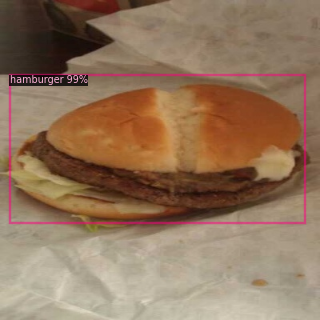

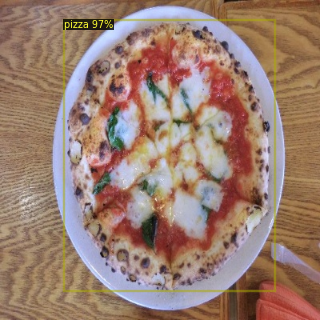

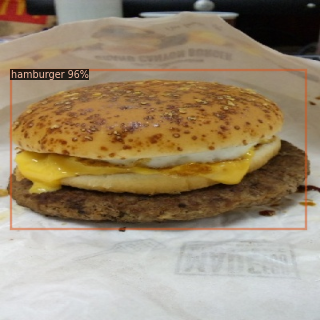

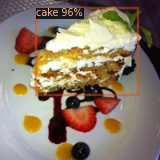

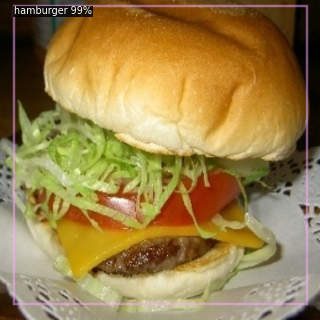

...

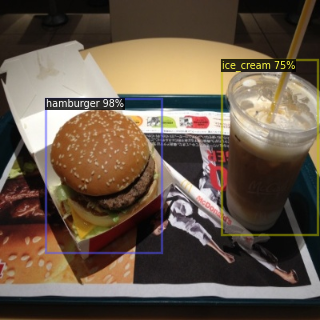

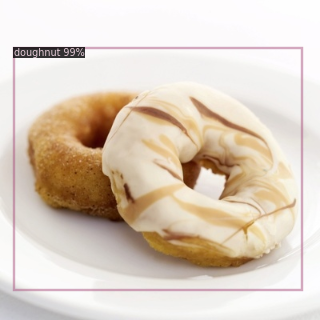

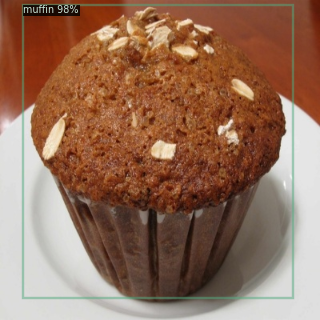

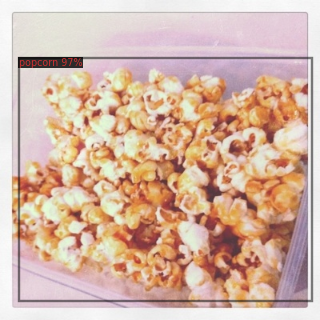

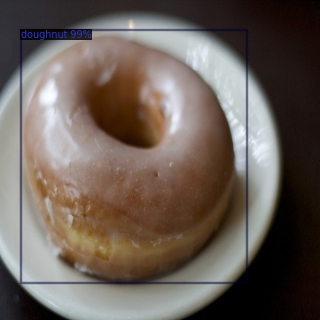

In [15]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('./Bbox/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])


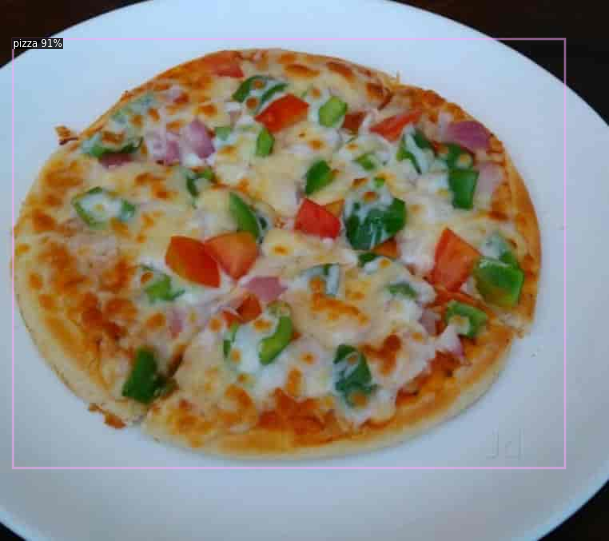

In [27]:
import urllib.request
import numpy as np

url = "https://content.jdmagicbox.com/comp/nashik/y6/0253px253.x253.170913131936.h7y6/catalogue/fannito-pizza-indira-nagar-nashik-nashik-pizza-outlets-bqwrtaufz8.jpg"
url_response = urllib.request.urlopen(url)
img_array = np.array(bytearray(url_response.read()), dtype=np.uint8)
img = cv2.imdecode(img_array, -1)
outputs = predictor(img)
v = Visualizer(img[:, :, ::-1],
              metadata=test_metadata, 
              scale=0.8
                )
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])
# cv2_imshow(img)